# Convolutional Neural Networks

## Project: Write an Algorithm for a Dog Identification App 

---

In this notebook, some template code has already been provided for you, and you will need to implement additional functionality to successfully complete this project. You will not need to modify the included code beyond what is requested. Sections that begin with **'(IMPLEMENTATION)'** in the header indicate that the following block of code will require additional functionality which you must provide. Instructions will be provided for each section, and the specifics of the implementation are marked in the code block with a 'TODO' statement. Please be sure to read the instructions carefully! 

> **Note**: Once you have completed all of the code implementations, you need to finalize your work by exporting the Jupyter Notebook as an HTML document. Before exporting the notebook to html, all of the code cells need to have been run so that reviewers can see the final implementation and output. You can then export the notebook by using the menu above and navigating to **File -> Download as -> HTML (.html)**. Include the finished document along with this notebook as your submission.

In addition to implementing code, there will be questions that you must answer which relate to the project and your implementation. Each section where you will answer a question is preceded by a **'Question X'** header. Carefully read each question and provide thorough answers in the following text boxes that begin with **'Answer:'**. Your project submission will be evaluated based on your answers to each of the questions and the implementation you provide.

>**Note:** Code and Markdown cells can be executed using the **Shift + Enter** keyboard shortcut.  Markdown cells can be edited by double-clicking the cell to enter edit mode.

The rubric contains _optional_ "Stand Out Suggestions" for enhancing the project beyond the minimum requirements. If you decide to pursue the "Stand Out Suggestions", you should include the code in this Jupyter notebook.



---
### Why We're Here 

In this notebook, you will make the first steps towards developing an algorithm that could be used as part of a mobile or web app.  At the end of this project, your code will accept any user-supplied image as input.  If a dog is detected in the image, it will provide an estimate of the dog's breed.  If a human is detected, it will provide an estimate of the dog breed that is most resembling.  The image below displays potential sample output of your finished project (... but we expect that each student's algorithm will behave differently!). 

![Sample Dog Output](images/sample_dog_output.png)

In this real-world setting, you will need to piece together a series of models to perform different tasks; for instance, the algorithm that detects humans in an image will be different from the CNN that infers dog breed.  There are many points of possible failure, and no perfect algorithm exists.  Your imperfect solution will nonetheless create a fun user experience!

### The Road Ahead

We break the notebook into separate steps.  Feel free to use the links below to navigate the notebook.

* [Step 0](#step0): Import Datasets
* [Step 1](#step1): Detect Humans
* [Step 2](#step2): Detect Dogs
* [Step 3](#step3): Create a CNN to Classify Dog Breeds (from Scratch)
* [Step 4](#step4): Create a CNN to Classify Dog Breeds (using Transfer Learning)
* [Step 5](#step5): Write your Algorithm
* [Step 6](#step6): Test Your Algorithm

---
<a id='step0'></a>
## Step 0: Import Datasets

Make sure that you've downloaded the required human and dog datasets:

**Note: if you are using the Udacity workspace, you *DO NOT* need to re-download these - they can be found in the `/data` folder as noted in the cell below.**

* Download the [dog dataset](https://s3-us-west-1.amazonaws.com/udacity-aind/dog-project/dogImages.zip).  Unzip the folder and place it in this project's home directory, at the location `/dog_images`. 

* Download the [human dataset](https://s3-us-west-1.amazonaws.com/udacity-aind/dog-project/lfw.zip).  Unzip the folder and place it in the home directory, at location `/lfw`.  

*Note: If you are using a Windows machine, you are encouraged to use [7zip](http://www.7-zip.org/) to extract the folder.*

In the code cell below, we save the file paths for both the human (LFW) dataset and dog dataset in the numpy arrays `human_files` and `dog_files`.

In [1]:
import numpy as np
from glob import glob

# load filenames for human and dog images
human_files = np.array(glob("/data/lfw/*/*"))
dog_files = np.array(glob("/data/dog_images/*/*/*"))

# print number of images in each dataset
print('There are %d total human images.' % len(human_files))
print('There are %d total dog images.' % len(dog_files))

There are 13233 total human images.
There are 8351 total dog images.


<a id='step1'></a>
## Step 1: Detect Humans

In this section, we use OpenCV's implementation of [Haar feature-based cascade classifiers](http://docs.opencv.org/trunk/d7/d8b/tutorial_py_face_detection.html) to detect human faces in images.  

OpenCV provides many pre-trained face detectors, stored as XML files on [github](https://github.com/opencv/opencv/tree/master/data/haarcascades).  We have downloaded one of these detectors and stored it in the `haarcascades` directory.  In the next code cell, we demonstrate how to use this detector to find human faces in a sample image.

Number of faces detected: 1


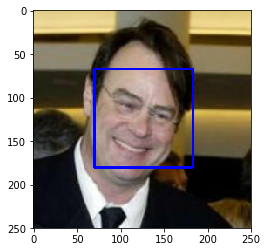

In [2]:
import cv2                
import matplotlib.pyplot as plt                        
%matplotlib inline                               

# extract pre-trained face detector
face_cascade = cv2.CascadeClassifier('haarcascades/haarcascade_frontalface_alt.xml')

# load color (BGR) image
img = cv2.imread(human_files[0])
# convert BGR image to grayscale
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

# find faces in image
faces = face_cascade.detectMultiScale(gray)

# print number of faces detected in the image
print('Number of faces detected:', len(faces))

# get bounding box for each detected face
for (x,y,w,h) in faces:
    # add bounding box to color image
    cv2.rectangle(img,(x,y),(x+w,y+h),(255,0,0),2)
    
# convert BGR image to RGB for plotting
cv_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

# display the image, along with bounding box
plt.imshow(cv_rgb)
plt.show()

Before using any of the face detectors, it is standard procedure to convert the images to grayscale.  The `detectMultiScale` function executes the classifier stored in `face_cascade` and takes the grayscale image as a parameter.  

In the above code, `faces` is a numpy array of detected faces, where each row corresponds to a detected face.  Each detected face is a 1D array with four entries that specifies the bounding box of the detected face.  The first two entries in the array (extracted in the above code as `x` and `y`) specify the horizontal and vertical positions of the top left corner of the bounding box.  The last two entries in the array (extracted here as `w` and `h`) specify the width and height of the box.

### Write a Human Face Detector

We can use this procedure to write a function that returns `True` if a human face is detected in an image and `False` otherwise.  This function, aptly named `face_detector`, takes a string-valued file path to an image as input and appears in the code block below.

In [3]:
# returns "True" if face is detected in image stored at img_path
def face_detector(img_path):
    img = cv2.imread(img_path)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    faces = face_cascade.detectMultiScale(gray)
    return len(faces) > 0

### (IMPLEMENTATION) Assess the Human Face Detector

__Question 1:__ Use the code cell below to test the performance of the `face_detector` function.  
- What percentage of the first 100 images in `human_files` have a detected human face?  
- What percentage of the first 100 images in `dog_files` have a detected human face? 

Ideally, we would like 100% of human images with a detected face and 0% of dog images with a detected face.  You will see that our algorithm falls short of this goal, but still gives acceptable performance.  We extract the file paths for the first 100 images from each of the datasets and store them in the numpy arrays `human_files_short` and `dog_files_short`.

__Answer:__ 

We detected 98 % as humans in the human file

We detected 17 % as humans in the dogs file

In [4]:
from tqdm import tqdm

human_files_short = human_files[:100]
dog_files_short = dog_files[:100]

#-#-# Do NOT modify the code above this line. #-#-#

## TODO: Test the performance of the face_detector algorithm 
## on the images in human_files_short and dog_files_short.
counter_human = 0;
counter_dog = 0;
for human in human_files_short:
    if (face_detector(human)):
        counter_human += 1

for dog in dog_files_short:
    if (face_detector(dog)):
        counter_dog += 1
print('We detected',counter_human, '% as humans in the human file')
print('We detected',counter_dog, '% as humans in the dogs file')


We detected 98 % as humans in the human file
We detected 17 % as humans in the dogs file


We suggest the face detector from OpenCV as a potential way to detect human images in your algorithm, but you are free to explore other approaches, especially approaches that make use of deep learning :).  Please use the code cell below to design and test your own face detection algorithm.  If you decide to pursue this _optional_ task, report performance on `human_files_short` and `dog_files_short`.

In [5]:
### (Optional) 
### TODO: Test performance of anotherface detection algorithm.
### Feel free to use as many code cells as needed.

---
<a id='step2'></a>
## Step 2: Detect Dogs

In this section, we use a [pre-trained model](http://pytorch.org/docs/master/torchvision/models.html) to detect dogs in images.  

### Obtain Pre-trained VGG-16 Model

The code cell below downloads the VGG-16 model, along with weights that have been trained on [ImageNet](http://www.image-net.org/), a very large, very popular dataset used for image classification and other vision tasks.  ImageNet contains over 10 million URLs, each linking to an image containing an object from one of [1000 categories](https://gist.github.com/yrevar/942d3a0ac09ec9e5eb3a).  

In [6]:
import torch
import torchvision.models as models

# define VGG16 model
VGG16 = models.vgg16(pretrained=True)

# check if CUDA is available
use_cuda = torch.cuda.is_available()

# move model to GPU if CUDA is available
if use_cuda:
    VGG16 = VGG16.cuda()

Downloading: "https://download.pytorch.org/models/vgg16-397923af.pth" to /root/.torch/models/vgg16-397923af.pth
100%|██████████| 553433881/553433881 [00:05<00:00, 106740067.07it/s]


Given an image, this pre-trained VGG-16 model returns a prediction (derived from the 1000 possible categories in ImageNet) for the object that is contained in the image.

### (IMPLEMENTATION) Making Predictions with a Pre-trained Model

In the next code cell, you will write a function that accepts a path to an image (such as `'dogImages/train/001.Affenpinscher/Affenpinscher_00001.jpg'`) as input and returns the index corresponding to the ImageNet class that is predicted by the pre-trained VGG-16 model.  The output should always be an integer between 0 and 999, inclusive.

Before writing the function, make sure that you take the time to learn  how to appropriately pre-process tensors for pre-trained models in the [PyTorch documentation](http://pytorch.org/docs/stable/torchvision/models.html).

In [7]:
from PIL import Image
import torchvision.transforms as transforms

def VGG16_predict(img_path):
    '''
    Use pre-trained VGG-16 model to obtain index corresponding to 
    predicted ImageNet class for image at specified path
    
    Args:
        img_path: path to an image
        
    Returns:
        Index corresponding to VGG-16 model's prediction
    '''
    ## TODO: Complete the function.
    ## Load and pre-process an image from the given img_path
    ## Return the *index* of the predicted class for that image
    
    img = Image.open(img_path)
    normalize = transforms.Compose([transforms.Resize((224,224)),transforms.CenterCrop((224,224)), transforms.ToTensor(), transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])])
    img=normalize(img)
    #display(img)
    img = img.unsqueeze(0).to('cuda') # unsqueeze to add artificial first dimension
    
    return  torch.argmax(VGG16(img))# predicted class index



### (IMPLEMENTATION) Write a Dog Detector

While looking at the [dictionary](https://gist.github.com/yrevar/942d3a0ac09ec9e5eb3a), you will notice that the categories corresponding to dogs appear in an uninterrupted sequence and correspond to dictionary keys 151-268, inclusive, to include all categories from `'Chihuahua'` to `'Mexican hairless'`.  Thus, in order to check to see if an image is predicted to contain a dog by the pre-trained VGG-16 model, we need only check if the pre-trained model predicts an index between 151 and 268 (inclusive).

Use these ideas to complete the `dog_detector` function below, which returns `True` if a dog is detected in an image (and `False` if not).

In [8]:
### returns "True" if a dog is detected in the image stored at img_path
def dog_detector(img_path):
    ## TODO: Complete the function.
    prediction = VGG16_predict(img_path)
    return ((prediction <= 268) & (prediction >= 151)) # true/false

### (IMPLEMENTATION) Assess the Dog Detector

__Question 2:__ Use the code cell below to test the performance of your `dog_detector` function.  
- What percentage of the images in `human_files_short` have a detected dog?  
- What percentage of the images in `dog_files_short` have a detected dog?

__Answer:__ 

We detected 3 % as dogs in the human file

We detected 100 % as dogs in the dogs file

In [9]:
### TODO: Test the performance of the dog_detector function
### on the images in human_files_short and dog_files_short.
counter_human = 0;
counter_dog = 0;
for human in human_files_short:
    #display(Image.open(human))
    if (dog_detector(human)):
        counter_human += 1

for dog in dog_files_short:
    #display(Image.open(dog))
    if (dog_detector(dog)):
        counter_dog += 1
print('We detected',counter_human, '% as dogs in the human file')
print('We detected',counter_dog, '% as dogs in the dogs file')

We detected 2 % as dogs in the human file
We detected 100 % as dogs in the dogs file


We suggest VGG-16 as a potential network to detect dog images in your algorithm, but you are free to explore other pre-trained networks (such as [Inception-v3](http://pytorch.org/docs/master/torchvision/models.html#inception-v3), [ResNet-50](http://pytorch.org/docs/master/torchvision/models.html#id3), etc).  Please use the code cell below to test other pre-trained PyTorch models.  If you decide to pursue this _optional_ task, report performance on `human_files_short` and `dog_files_short`.

In [10]:
### (Optional) 
### TODO: Report the performance of another pre-trained network.
### Feel free to use as many code cells as needed.

---
<a id='step3'></a>
## Step 3: Create a CNN to Classify Dog Breeds (from Scratch)

Now that we have functions for detecting humans and dogs in images, we need a way to predict breed from images.  In this step, you will create a CNN that classifies dog breeds.  You must create your CNN _from scratch_ (so, you can't use transfer learning _yet_!), and you must attain a test accuracy of at least 10%.  In Step 4 of this notebook, you will have the opportunity to use transfer learning to create a CNN that attains greatly improved accuracy.

We mention that the task of assigning breed to dogs from images is considered exceptionally challenging.  To see why, consider that *even a human* would have trouble distinguishing between a Brittany and a Welsh Springer Spaniel.  

Brittany | Welsh Springer Spaniel
- | - 
<img src="images/Brittany_02625.jpg" width="100"> | <img src="images/Welsh_springer_spaniel_08203.jpg" width="200">

It is not difficult to find other dog breed pairs with minimal inter-class variation (for instance, Curly-Coated Retrievers and American Water Spaniels).  

Curly-Coated Retriever | American Water Spaniel
- | -
<img src="images/Curly-coated_retriever_03896.jpg" width="200"> | <img src="images/American_water_spaniel_00648.jpg" width="200">


Likewise, recall that labradors come in yellow, chocolate, and black.  Your vision-based algorithm will have to conquer this high intra-class variation to determine how to classify all of these different shades as the same breed.  

Yellow Labrador | Chocolate Labrador | Black Labrador
- | -
<img src="images/Labrador_retriever_06457.jpg" width="150"> | <img src="images/Labrador_retriever_06455.jpg" width="240"> | <img src="images/Labrador_retriever_06449.jpg" width="220">

We also mention that random chance presents an exceptionally low bar: setting aside the fact that the classes are slightly imabalanced, a random guess will provide a correct answer roughly 1 in 133 times, which corresponds to an accuracy of less than 1%.  

Remember that the practice is far ahead of the theory in deep learning.  Experiment with many different architectures, and trust your intuition.  And, of course, have fun!

### (IMPLEMENTATION) Specify Data Loaders for the Dog Dataset

Use the code cell below to write three separate [data loaders](http://pytorch.org/docs/stable/data.html#torch.utils.data.DataLoader) for the training, validation, and test datasets of dog images (located at `dog_images/train`, `dog_images/valid`, and `dog_images/test`, respectively).  You may find [this documentation on custom datasets](http://pytorch.org/docs/stable/torchvision/datasets.html) to be a useful resource.  If you are interested in augmenting your training and/or validation data, check out the wide variety of [transforms](http://pytorch.org/docs/stable/torchvision/transforms.html?highlight=transform)!

In [11]:
### TODO: Write data loaders for training, validation, and test sets
## Specify appropriate transforms, and batch_sizes

from torch.utils.data import DataLoader
from torchvision import datasets
from skimage import io 

#not sure what the next two lines are doing but they help to avoid error in model...
from PIL import ImageFile
ImageFile.LOAD_TRUNCATED_IMAGES = True

transformation_train = transforms.Compose([
    transforms.Resize(256),
    transforms.CenterCrop(256),
    transforms.RandomHorizontalFlip(),
    transforms.RandomRotation(10),
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
    ])
transformation_validate = transforms.Compose([
    transforms.Resize(256),
    transforms.CenterCrop(256),
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
    ])
transformation_test = transforms.Compose([
    transforms.Resize(256),
    transforms.CenterCrop(256),
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
    ])

dataset_train = datasets.ImageFolder(root='/data/dog_images/train/',transform=transformation_train)
dataset_validate = datasets.ImageFolder(root='/data/dog_images/valid/',transform=transformation_validate)
dataset_test = datasets.ImageFolder(root='/data/dog_images/test/',transform=transformation_test)

data_loader_train = DataLoader(dataset_train,batch_size = 20,shuffle=True)
data_loader_validate = DataLoader(dataset_validate,batch_size = 20)
data_loader_test = DataLoader(dataset_test,batch_size = 20)


In [12]:
classes = dataset_train.classes
for brew in classes:
    print(brew)

001.Affenpinscher
002.Afghan_hound
003.Airedale_terrier
004.Akita
005.Alaskan_malamute
006.American_eskimo_dog
007.American_foxhound
008.American_staffordshire_terrier
009.American_water_spaniel
010.Anatolian_shepherd_dog
011.Australian_cattle_dog
012.Australian_shepherd
013.Australian_terrier
014.Basenji
015.Basset_hound
016.Beagle
017.Bearded_collie
018.Beauceron
019.Bedlington_terrier
020.Belgian_malinois
021.Belgian_sheepdog
022.Belgian_tervuren
023.Bernese_mountain_dog
024.Bichon_frise
025.Black_and_tan_coonhound
026.Black_russian_terrier
027.Bloodhound
028.Bluetick_coonhound
029.Border_collie
030.Border_terrier
031.Borzoi
032.Boston_terrier
033.Bouvier_des_flandres
034.Boxer
035.Boykin_spaniel
036.Briard
037.Brittany
038.Brussels_griffon
039.Bull_terrier
040.Bulldog
041.Bullmastiff
042.Cairn_terrier
043.Canaan_dog
044.Cane_corso
045.Cardigan_welsh_corgi
046.Cavalier_king_charles_spaniel
047.Chesapeake_bay_retriever
048.Chihuahua
049.Chinese_crested
050.Chinese_shar-pei
051.Chow_c

**Question 3:** Describe your chosen procedure for preprocessing the data. 
- How does your code resize the images (by cropping, stretching, etc)?  What size did you pick for the input tensor, and why?
- Did you decide to augment the dataset?  If so, how (through translations, flips, rotations, etc)?  If not, why not?


**Answer**:

I croped and resized the images to size 256 * 256 and turned it in a tensor in the next step. i decided for 256 = 2^8 to have it nicely scalable in the further steps.

I went for basic augmentation by random rotarion of 10° and random horizontal flip in the training dataset



### (IMPLEMENTATION) Model Architecture

Create a CNN to classify dog breed.  Use the template in the code cell below.

In [13]:
import torch.nn as nn
import torch.nn.functional as F

# define the CNN architecture
class Net(nn.Module):
    ### TODO: choose an architecture, and complete the class
    def __init__(self):
        super(Net, self).__init__()
        ## Define layers of a CNN
        self.conv1 = nn.Conv2d(3,16,3,padding=1)       
        self.conv2 = nn.Conv2d(16,32,3,padding=1)
        self.conv3 = nn.Conv2d(32,64,3,padding=1)
        self.conv4 = nn.Conv2d(64,128,3,padding=1)
        #self.conv5 = nn.Conv2d(128,256,3,padding=1)
        self.pool  = nn.MaxPool2d(2,2)
        
        self.fc1 = nn.Linear(16 * 16 * 128, 2048)
        self.fc2 = nn.Linear(2048,1024)
        self.fc3 = nn.Linear(1024,133)
        
        self.conv_bn1 = nn.BatchNorm2d(16)
        self.conv_bn2 = nn.BatchNorm2d(32)
        self.conv_bn3 = nn.BatchNorm2d(64)
        self.conv_bn4 = nn.BatchNorm2d(128)
        #self.conv_bn5 = nn.BatchNorm2d(256)
        
        self.dropout = nn.Dropout(0.2)

    
    def forward(self, x):
        ## Define forward behavior
        x = self.pool(self.conv_bn1(F.relu(self.conv1(x))))     # 256 * 256 * 3  -> 128 * 128 * 16
        x = self.pool(self.conv_bn2(F.relu(self.conv2(x))))     # 128 * 128 * 16 -> 64 * 64 * 32
        x = self.pool(self.conv_bn3(F.relu(self.conv3(x))))     # 64 * 64* 32 -> 32 * 32 * 64
        x = self.pool(self.conv_bn4(F.relu(self.conv4(x))))     # 32 * 32 * 64 -> 16 * 16 * 128
        #x = self.pool(self.conv_bn5(F.relu(self.conv5(x))))     # 16 * 16 * 128 -> 8 * 8 * 256

        x = x.view(-1,16 * 16 * 128)             # 7 * 7 * 256 -> 2048
        x = F.relu(self.fc1(x))                  # 2048 -> 1024 brews
        x = self.dropout(x)
        x = F.relu(self.fc2(x))                  # 1024 -> 133 brews
        x = self.dropout(x)
        x = self.fc3(x)
        return x

#-#-# You so NOT have to modify the code below this line. #-#-#

# instantiate the CNN
model_scratch = Net()

# move tensors to GPU if CUDA is available
if use_cuda:
    model_scratch.cuda()

__Question 4:__ Outline the steps you took to get to your final CNN architecture and your reasoning at each step.  

__Answer:__ 

I increased the depth of the layers step by step and ended with a depth of 128. in between all concolutional layers i added a max pooling layer that resuces the area of the 'image' by factor 4. Besides that research in the internet and other classifiers available online pointed me to a batch normalization layer that normalizes the data of each batch as described [here](https://pytorch.org/docs/stable/generated/torch.nn.BatchNorm2d.html). I added a batch normalization layer between all conv and pooling layers to increase the solution quality. After my convolutional layers I added three fully connected layer that reduce the number of features from 32768 ->2048 -> 1024 -> 133 to end up in the brews of the dogs.

### (IMPLEMENTATION) Specify Loss Function and Optimizer

Use the next code cell to specify a [loss function](http://pytorch.org/docs/stable/nn.html#loss-functions) and [optimizer](http://pytorch.org/docs/stable/optim.html).  Save the chosen loss function as `criterion_scratch`, and the optimizer as `optimizer_scratch` below.

In [14]:
import torch.optim as optim

### TODO: select loss function
criterion_scratch = nn.CrossEntropyLoss()

### TODO: select optimizer
optimizer_scratch = torch.optim.Adam(model_scratch.parameters(), lr=0.001)


### (IMPLEMENTATION) Train and Validate the Model

Train and validate your model in the code cell below.  [Save the final model parameters](http://pytorch.org/docs/master/notes/serialization.html) at filepath `'model_scratch.pt'`.

In [15]:
def train(n_epochs, data_loader_train, data_loader_validate, model, optimizer, criterion, use_cuda, save_path):
    """returns trained model"""
    # initialize tracker for minimum validation loss
    valid_loss_min = np.Inf 
    
    for epoch in range(1, n_epochs+1):
        # initialize variables to monitor training and validation loss
        train_loss = 0.0
        valid_loss = 0.0
        
        ###################
        # train the model #
        ###################
        model.train()
        for batch_idx, (data, target) in enumerate(data_loader_train):
            # move to GPU
            if use_cuda:
                data, target = data.cuda(), target.cuda()
                
            optimizer.zero_grad()
            output = model(data)
            loss = criterion(output,target)
            loss.backward()
            optimizer.step()
            ## find the loss and update the model parameters accordingly
            ## record the average training loss, using something like
            train_loss = train_loss + ((1 / (batch_idx + 1)) * (loss.data - train_loss))
            
        ######################    
        # validate the model #
        ######################
        model.eval()
        for batch_idx, (data, target) in enumerate(data_loader_validate):
            # move to GPU
            if use_cuda:
                data, target = data.cuda(), target.cuda()
            ## update the average validation loss
            output = model(data)
            loss = criterion(output,target)
            valid_loss = valid_loss + ((1 / (batch_idx + 1)) * (loss.data - valid_loss))
            
        # print training/validation statistics 
        print(f'Epoch: {epoch} \tTraining Loss: {train_loss} \tValidation Loss: {valid_loss}')
        
        ## TODO: save the model if validation loss has decreased
        if valid_loss < valid_loss_min:
            print(f'Validation loss decreased from {valid_loss_min} to {valid_loss}.  Saving model ...')
            torch.save(model.state_dict(),save_path)
            valid_loss_min = valid_loss
    # return trained model
    return model


# train the model
model_scratch = train(20, data_loader_train, data_loader_validate, model_scratch, optimizer_scratch, 
                      criterion_scratch, use_cuda, 'model_scratch.pt')



Epoch: 1 	Training Loss: 4.810904502868652 	Validation Loss: 4.556180477142334
Validation loss decreased from inf to 4.556180477142334.  Saving model ...
Epoch: 2 	Training Loss: 4.564329624176025 	Validation Loss: 4.387361526489258
Validation loss decreased from 4.556180477142334 to 4.387361526489258.  Saving model ...
Epoch: 3 	Training Loss: 4.375672817230225 	Validation Loss: 4.258118629455566
Validation loss decreased from 4.387361526489258 to 4.258118629455566.  Saving model ...
Epoch: 4 	Training Loss: 4.225637912750244 	Validation Loss: 4.116283893585205
Validation loss decreased from 4.258118629455566 to 4.116283893585205.  Saving model ...
Epoch: 5 	Training Loss: 4.094132900238037 	Validation Loss: 4.011231899261475
Validation loss decreased from 4.116283893585205 to 4.011231899261475.  Saving model ...
Epoch: 6 	Training Loss: 3.975861072540283 	Validation Loss: 3.8979673385620117
Validation loss decreased from 4.011231899261475 to 3.8979673385620117.  Saving model ...
Epoc

In [16]:
# load the model that got the best validation accuracy
model_scratch.load_state_dict(torch.load('model_scratch.pt'))

### (IMPLEMENTATION) Test the Model

Try out your model on the test dataset of dog images.  Use the code cell below to calculate and print the test loss and accuracy.  Ensure that your test accuracy is greater than 10%.

In [17]:
def test(data_loader_test, model, criterion, use_cuda):

    # monitor test loss and accuracy
    test_loss = 0.
    correct = 0.
    total = 0.

    model.eval()
    for batch_idx, (data, target) in enumerate(data_loader_test):
        # move to GPU
        if use_cuda:
            data, target = data.cuda(), target.cuda()
        # forward pass: compute predicted outputs by passing inputs to the model
        output = model(data)
        # calculate the loss
        loss = criterion(output, target)
        # update average test loss 
        test_loss = test_loss + ((1 / (batch_idx + 1)) * (loss.data - test_loss))
        # convert output probabilities to predicted class
        pred = output.data.max(1, keepdim=True)[1]
        # compare predictions to true label
        correct += np.sum(np.squeeze(pred.eq(target.data.view_as(pred))).cpu().numpy())
        total += data.size(0)
            
    print('Test Loss: {:.6f}\n'.format(test_loss))

    print('\nTest Accuracy: %2d%% (%2d/%2d)' % (
        100. * correct / total, correct, total))

# call test function    
test(data_loader_test, model_scratch, criterion_scratch, use_cuda)

Test Loss: 3.668148


Test Accuracy: 15% (128/836)


---
<a id='step4'></a>
## Step 4: Create a CNN to Classify Dog Breeds (using Transfer Learning)

You will now use transfer learning to create a CNN that can identify dog breed from images.  Your CNN must attain at least 60% accuracy on the test set.

### (IMPLEMENTATION) Specify Data Loaders for the Dog Dataset

Use the code cell below to write three separate [data loaders](http://pytorch.org/docs/master/data.html#torch.utils.data.DataLoader) for the training, validation, and test datasets of dog images (located at `dogImages/train`, `dogImages/valid`, and `dogImages/test`, respectively). 

If you like, **you are welcome to use the same data loaders from the previous step**, when you created a CNN from scratch.

In [18]:
### TODO: Write data loaders for training, validation, and test sets
## Specify appropriate transforms, and batch_sizes

from torch.utils.data import DataLoader
from torchvision import datasets
from skimage import io 

#not sure what the next two lines are doing but they help to avoid error in model...
from PIL import ImageFile
ImageFile.LOAD_TRUNCATED_IMAGES = True

transformation_train = transforms.Compose([
    transforms.Resize(224),
    transforms.CenterCrop(224),
    transforms.RandomHorizontalFlip(),
    transforms.RandomRotation(10),
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
    ])
transformation_validate = transforms.Compose([
    transforms.Resize(224),
    transforms.CenterCrop(224),
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
    ])
transformation_test = transforms.Compose([
    transforms.Resize(224),
    transforms.CenterCrop(224),
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
    ])

dataset_train = datasets.ImageFolder(root='/data/dog_images/train/',transform=transformation_train)
dataset_validate = datasets.ImageFolder(root='/data/dog_images/valid/',transform=transformation_validate)
dataset_test = datasets.ImageFolder(root='/data/dog_images/test/',transform=transformation_test)

data_loader_train = DataLoader(dataset_train,batch_size = 20,shuffle=True)
data_loader_validate = DataLoader(dataset_validate,batch_size = 20)
data_loader_test = DataLoader(dataset_test,batch_size = 20)


### (IMPLEMENTATION) Model Architecture

Use transfer learning to create a CNN to classify dog breed.  Use the code cell below, and save your initialized model as the variable `model_transfer`.

In [19]:
import torchvision.models as models
import torch.nn as nn

## TODO: Specify model architecture 
# vgg16
# resnet18
model_transfer = models.densenet121(pretrained=True)

#print(model_transfer)

#DENSENET121
print(model_transfer.classifier.in_features) 
print(model_transfer.classifier.out_features) 

#RASNSNET18
#print(model_transfer.fc.in_features) 
#print(model_transfer.fc.out_features) 


#VGG16
#print(model_transfer.classifier[6].in_features) 
#print(model_transfer.classifier[6].out_features) 

#for param in model_transfer.features.parameters():
#    param.requires_grad = False



/opt/conda/lib/python3.6/site-packages/torchvision-0.2.1-py3.6.egg/torchvision/models/densenet.py:212: UserWarning: nn.init.kaiming_normal is now deprecated in favor of nn.init.kaiming_normal_.
Downloading: "https://download.pytorch.org/models/densenet121-a639ec97.pth" to /root/.torch/models/densenet121-a639ec97.pth
100%|██████████| 32342954/32342954 [00:00<00:00, 77975287.78it/s]


1024
1000


In [20]:
print(model_transfer)

DenseNet(
  (features): Sequential(
    (conv0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (norm0): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu0): ReLU(inplace)
    (pool0): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (denseblock1): _DenseBlock(
      (denselayer1): _DenseLayer(
        (norm1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu1): ReLU(inplace)
        (conv1): Conv2d(64, 128, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (norm2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu2): ReLU(inplace)
        (conv2): Conv2d(128, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      )
      (denselayer2): _DenseLayer(
        (norm1): BatchNorm2d(96, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu1): ReLU(inplac

In [21]:

#densenet
model_transfer.classifier = nn.Linear(1024, 133)
for param in model_transfer.features.parameters():
    param.requires_grad = False
    
    
#vgg
#model_transfer.classifier[6] = nn.Linear(512, 133)


use_cuda = torch.cuda.is_available()
if use_cuda:
    model_transfer = model_transfer.cuda()
    
print(model_transfer)

DenseNet(
  (features): Sequential(
    (conv0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (norm0): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu0): ReLU(inplace)
    (pool0): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (denseblock1): _DenseBlock(
      (denselayer1): _DenseLayer(
        (norm1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu1): ReLU(inplace)
        (conv1): Conv2d(64, 128, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (norm2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu2): ReLU(inplace)
        (conv2): Conv2d(128, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      )
      (denselayer2): _DenseLayer(
        (norm1): BatchNorm2d(96, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu1): ReLU(inplac

__Question 5:__ Outline the steps you took to get to your final CNN architecture and your reasoning at each step.  Describe why you think the architecture is suitable for the current problem.

__Answer:__ 

I tried around with different pretrained models like vgg, rasnet a but finally ended up with densenet, which acctually performs quite good. I replaced the fully connected layer which initially sorts the data in 1000 classes by a new one that sorts only in 133 classes which represent our dog brews.

### (IMPLEMENTATION) Specify Loss Function and Optimizer

Use the next code cell to specify a [loss function](http://pytorch.org/docs/master/nn.html#loss-functions) and [optimizer](http://pytorch.org/docs/master/optim.html).  Save the chosen loss function as `criterion_transfer`, and the optimizer as `optimizer_transfer` below.

In [22]:
criterion_transfer = nn.CrossEntropyLoss()

#DENSENET121
optimizer_transfer = torch.optim.Adam(model_transfer.classifier.parameters(),lr=0.001)

#RESNET18
#optimizer_transfer = torch.optim.Adam(model_transfer.fc.parameters(),lr=0.001)


### (IMPLEMENTATION) Train and Validate the Model

Train and validate your model in the code cell below.  [Save the final model parameters](http://pytorch.org/docs/master/notes/serialization.html) at filepath `'model_transfer.pt'`.

In [23]:
# train the model

# NOTE, I increased the epochs step by step to get a feeling how the model precision develops over time. The final
# model was trained in 40 epochs.

def train(n_epochs, loaders_transfer, model_transfer, optimizer_transfer, criterion_transfer, use_cuda, save_path):
    
    for epoch in range(1, n_epochs+1):

        # keep track of training and validation loss
        train_loss = 0.0

        for batch_i, (data, target) in enumerate(loaders_transfer):
            # move tensors to GPU if CUDA is available
            if use_cuda:
                data, target = data.cuda(), target.cuda()
            # clear the gradients of all optimized variables
            optimizer_transfer.zero_grad()
            # forward pass: compute predicted outputs by passing inputs to the model
            output = model_transfer(data)
            # calculate the batch loss
            loss = criterion_transfer(output, target)
            # backward pass: compute gradient of the loss with respect to model parameters
            loss.backward()
            # perform a single optimization step (parameter update)
            optimizer_transfer.step()
            # update training loss
            train_loss += loss.item()

        print('Epoch: {} \tBatch: {:.6f} \tTaining Loss: {:.6f}'.format(epoch, batch_i+1, train_loss))

    torch.save(model_transfer.state_dict(),save_path)
    return model_transfer

model_transfer = train(20, data_loader_train, model_transfer, optimizer_transfer, criterion_transfer, use_cuda, 'model_transfer.pt')


# load the model that got the best validation accuracy (uncomment the line below)
#model_transfer.load_state_dict(torch.load('model_transfer.pt'))

Epoch: 1 	Batch: 334.000000 	Taining Loss: 804.057902
Epoch: 2 	Batch: 334.000000 	Taining Loss: 291.956455
Epoch: 3 	Batch: 334.000000 	Taining Loss: 201.683991
Epoch: 4 	Batch: 334.000000 	Taining Loss: 161.135798
Epoch: 5 	Batch: 334.000000 	Taining Loss: 135.153041
Epoch: 6 	Batch: 334.000000 	Taining Loss: 115.626069
Epoch: 7 	Batch: 334.000000 	Taining Loss: 104.294168
Epoch: 8 	Batch: 334.000000 	Taining Loss: 94.320725
Epoch: 9 	Batch: 334.000000 	Taining Loss: 83.498996
Epoch: 10 	Batch: 334.000000 	Taining Loss: 77.592903
Epoch: 11 	Batch: 334.000000 	Taining Loss: 73.679458
Epoch: 12 	Batch: 334.000000 	Taining Loss: 71.044848
Epoch: 13 	Batch: 334.000000 	Taining Loss: 62.051627
Epoch: 14 	Batch: 334.000000 	Taining Loss: 60.868579
Epoch: 15 	Batch: 334.000000 	Taining Loss: 54.389125
Epoch: 16 	Batch: 334.000000 	Taining Loss: 54.809484
Epoch: 17 	Batch: 334.000000 	Taining Loss: 48.736322
Epoch: 18 	Batch: 334.000000 	Taining Loss: 47.382500
Epoch: 19 	Batch: 334.000000 	

### (IMPLEMENTATION) Test the Model

Try out your model on the test dataset of dog images. Use the code cell below to calculate and print the test loss and accuracy.  Ensure that your test accuracy is greater than 60%.

In [24]:
model_transfer.load_state_dict(torch.load('model_transfer.pt'))

In [25]:
test(data_loader_test, model_transfer, criterion_transfer, use_cuda)

Test Loss: 0.627575


Test Accuracy: 83% (695/836)


### (IMPLEMENTATION) Predict Dog Breed with the Model

Write a function that takes an image path as input and returns the dog breed (`Affenpinscher`, `Afghan hound`, etc) that is predicted by your model.  

In [26]:
### TODO: Write a function that takes a path to an image as input
### and returns the dog breed that is predicted by the model.

# list of class names by index, i.e. a name can be accessed like class_names[0]
class_names = [item[4:].replace("_", " ") for item in dataset_train.classes]

import tensorflow as tf

from PIL import Image

def predict_breed_transfer(img_path, model_transfer=model_transfer):
    image = Image.open(img_path)
    
    transformation = transforms.Compose([
    transforms.Resize(224),
    transforms.CenterCrop(224),
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
    ])
    
    image = transformation(image)
    image = image[:3,:,:].unsqueeze(0)
    image = image.cuda()
    
    output = model_transfer(image)
    
    return class_names[output.cpu().data.numpy().argmax()]


predict_breed_transfer('images/Brittany_02625.jpg', model_transfer)

'Brittany'

---
<a id='step5'></a>
## Step 5: Write your Algorithm

Write an algorithm that accepts a file path to an image and first determines whether the image contains a human, dog, or neither.  Then,
- if a __dog__ is detected in the image, return the predicted breed.
- if a __human__ is detected in the image, return the resembling dog breed.
- if __neither__ is detected in the image, provide output that indicates an error.

You are welcome to write your own functions for detecting humans and dogs in images, but feel free to use the `face_detector` and `human_detector` functions developed above.  You are __required__ to use your CNN from Step 4 to predict dog breed.  

Some sample output for our algorithm is provided below, but feel free to design your own user experience!

![Sample Human Output](images/sample_human_output.png)


### (IMPLEMENTATION) Write your Algorithm

In [27]:
### TODO: Write your algorithm.
### Feel free to use as many code cells as needed.

def run_app(img_path):
    img = Image.open(img_path)
    display(img)
    dog = dog_detector(img_path)
    human = face_detector(img_path)
    
    if dog:
        dog_breed = predict_breed_transfer(img_path)
        print(f'We found a dog here, it is a {dog_breed}')
    elif human:
        human_breed = predict_breed_transfer(img_path)
        print(f'This human looks like a {human_breed}')
    else:
        print('Sorry, we could not detect a dog or human on the image...')
    
    return None    
    
    ## handle cases for a human face, dog, and neither
    
#run_app('images/Brittany_02625.jpg')

---
<a id='step6'></a>
## Step 6: Test Your Algorithm

In this section, you will take your new algorithm for a spin!  What kind of dog does the algorithm think that _you_ look like?  If you have a dog, does it predict your dog's breed accurately?  If you have a cat, does it mistakenly think that your cat is a dog?

### (IMPLEMENTATION) Test Your Algorithm on Sample Images!

Test your algorithm at least six images on your computer.  Feel free to use any images you like.  Use at least two human and two dog images.  

__Question 6:__ Is the output better than you expected :) ?  Or worse :( ?  Provide at least three possible points of improvement for your algorithm.

__Answer:__ The output is better than I expected when I starten this project. In general there are several ways to improve the final app:

- test and train different classifiers for dogs and humans to get better resulsts on the initial classification
- increase the number of epochs in the transferred brew detection to improve the result quality
- test different pretrained models and compare its results
- increase the variaty of input data

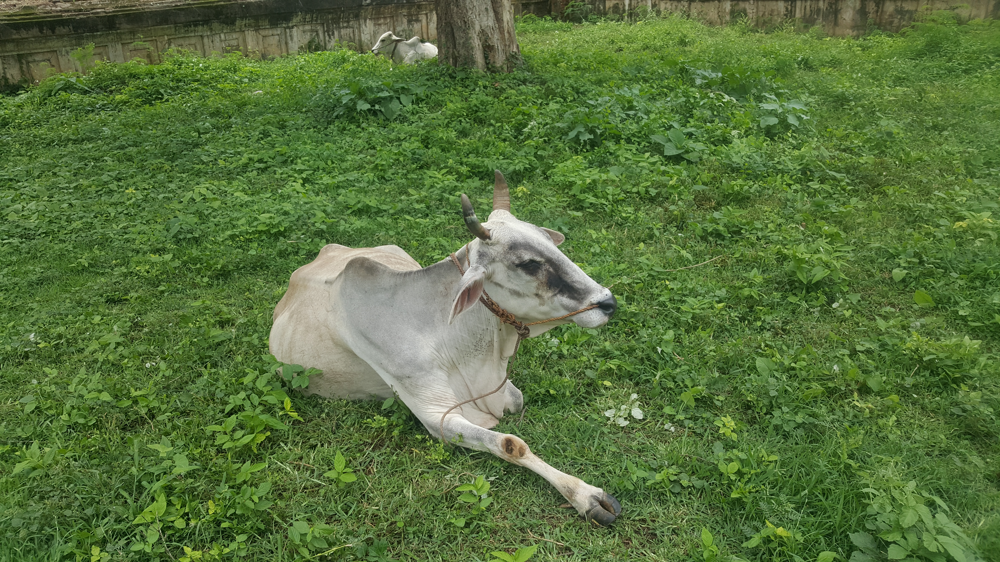

This human looks like a Italian greyhound


In [ ]:
## TODO: Execute your algorithm from Step 6 on
## at least 6 images on your computer.
## Feel free to use as many code cells as needed.

## suggested code, below
run_app('own_pics/1.jpg')
run_app('own_pics/2.jpg')
run_app('own_pics/3.jpg')
run_app('own_pics/4.jpg')
run_app('own_pics/5.jpg')

for file in np.hstack((human_files[:3], dog_files[:3])):
    run_app(file)
